# 기초 프로그램 만들기
## 02. 컴퓨터의 외부 및 내부 IP 확인

In [ ]:
conda install -n forty -c conda-forge requests -y

In [1]:
import requests
import re

req = requests.get("http://ipconfig.kr")

print(req)
print(type(req))

out_addr = re.search(r'IP Address : (\d{1,3}\.\d{1,3}\.\d{1,3}\.\d{1,3})', req.text)[1]
print(out_addr)

<Response [200]>
<class 'requests.models.Response'>
123.142.252.25


In [2]:
req?

Type:        Response
String form: <Response [200]>
File:        c:\users\r2com\.conda\envs\forty\lib\site-packages\requests\models.py
Docstring:  
The :class:`Response <Response>` object, which contains a
server's response to an HTTP request.


### cf.) 정규표현식(정규식)
* 정규식은 특정한 규칙을 가진 문자열의 집합을 표현하는 데 사용하는 형식 언어이다.
* 특정 검색 패턴에 대한 하나 이상의 일치 항목을 검색하여 텍스트에서 정보를 추출하는 데 유용하다.

##### email 주소 유효성 검사 정규표현식
* '계정@도메인.최상위도메인' 형식의 데이터를 찾는 정규표현식이다.
* '^[a-zA-Z0-9+-_.]+@[a-zA-Z0-9-]+\.[a-zA-Z0-9-.]+$'

##### 휴대폰 번호 유효성 검사 정규표현식
* '3자리 숫자 - 3자리 or 4자리 숫자 - 4자리 숫자' 형태의 데이터를 찾는 정규표현식이다.
* '\d{3}-\d{3,4}-\d{4}'


In [5]:
import re

print(re.search(r'IP Address : (\d{1,3}\.\d{1,3}\.\d{1,3}\.\d{1,3})', req.text))
print(re.search(r'IP Address : (\d{1,3}\.\d{1,3}\.\d{1,3}\.(\d{1,3}))', req.text)[0])
print(re.search(r'IP Address : (\d{1,3}\.\d{1,3}\.\d{1,3}\.(\d{1,3}))', req.text)[1])
print(re.search(r'IP Address : (\d{1,3}\.\d{1,3}\.\d{1,3}\.(\d{1,3}))', req.text)[2])

<re.Match object; span=(3697, 3724), match='IP Address : 123.142.252.25'>
IP Address : 123.142.252.25
123.142.252.25


In [6]:
import socket
import requests
import re

in_addr = socket.socket(socket.AF_INET, socket.SOCK_STREAM)
in_addr.connect(("www.google.co.kr", 443))
print("내부IP: ",in_addr.getsockname()[0])

req = requests.get("http://ipconfig.kr")
out_addr = re.search(r'IP Address : (\d{1,3}\.\d{1,3}\.\d{1,3}\.\d{1,3})', req.text)[1]
print("외부IP: ",out_addr)

내부IP:  192.168.0.29
외부IP:  123.142.252.25


## 03. 텍스트를 음성으로 변환

In [7]:
conda install -c conda-forge gtts -n forty

Solving environment: ...working... done

## Package Plan ##

  environment location: C:\Users\r2com\.conda\envs\forty

  added / updated specs:
    - gtts


The following packages will be downloaded:

    package                    |            build
    ---------------------------|-----------------
    click-8.1.3                |  py310h5588dad_0         149 KB  conda-forge
    gtts-2.2.4                 |     pyhd8ed1ab_0          27 KB  conda-forge
    ------------------------------------------------------------
                                           Total:         176 KB

The following NEW packages will be INSTALLED:

  click              conda-forge/win-64::click-8.1.3-py310h5588dad_0
  gtts               conda-forge/noarch::gtts-2.2.4-pyhd8ed1ab_0




gtts-2.2.4           | 27 KB     |            |   0% 
gtts-2.2.4           | 27 KB     | ########## | 100% 
gtts-2.2.4           | 27 KB     | ########## | 100% 

click-8.1.3          | 149 KB    |            |   0% 
click-8.1.



==> WARNING: A newer version of conda exists. <==
  current version: 4.10.3
  latest version: 4.12.0

Please update conda by running

    $ conda update -n base -c defaults conda




In [9]:
print('이름\나이 : \n홍길동\\22세') # raw text

이름\나이 : 
홍길동\22세


In [10]:
from gtts import gTTS

text = "안녕하세요. 파이썬과 40개의 작품들 입니다."

tts = gTTS(text=text, lang='ko')
tts.save(r"files\hi.mp3")


In [2]:
from gtts import gTTS
from playsound import playsound

text = "안녕하세요. 파이썬과 40개의 작품들 입니다."

tts = gTTS(text=text, lang='ko')
#tts.save(r"files\hi.mp3")

playsound("files/hi.mp3")


    Error 277 for command:
        open files/hi.mp3
    MCI를 초기화하는 데 문제가 발생했습니다.

    Error 263 for command:
        close files/hi.mp3
    지정한 장치가 열려 있지 않거나 MCI에서 인식되지 않습니다.
Failed to close the file: files/hi.mp3


PlaysoundException: 
    Error 277 for command:
        open files/hi.mp3
    MCI를 초기화하는 데 문제가 발생했습니다.

### cf.) 파이썬에서 파일 다루기

In [22]:
file = 'files/hello.txt'
f = open(file, 'w')         # file 존재하면 덮어씀
f.write('안녕하세요\n')
f.write('행복하시길 바랄게요')
f.close()

In [23]:
f = open(file, 'a')
f.write('\n')
f.write('학생명단\n')
f.write('-' * 15)
f.write('\n')
f.writelines(['홍길동', '이순신', '신사임당'])
f.close()

In [24]:
f = open(file, 'a')
f.write('\n')
f.write('학생명단\n')
f.write('-' * 15)
f.write('\n')
f.writelines('\n'.join(['홍길동', '이순신', '신사임당']))
f.close()

In [32]:
from gtts import gTTS
from playsound import playsound
import os

# 경로를 .py파일의 실행경로로 이동, 현재 경로로 이동
# os.chdir(os.path.dirname(os.path.abspath(__file__)))

file_path = 'files/나의텍스트.txt'
with open(file_path, 'rt', encoding='UTF8') as f : 
    read_file = f.read()

tts = gTTS(text=read_file, lang='ko')

tts.save("files/myText.mp3")


# playsound("myText.mp3")

### cf.) 파이썬 파일과 디렉토리 경로
> os.chdir(os.path.dirname(os.path.abspath(__file__)))

##### 현재 작업 폴더 얻기
* os.getcwd()

##### 디렉토리 변경
* os.chdir(path)

##### 경로 중 디렉토리명만 얻기
* os.path.dir(path)

#### 특정 경로에 대해 절대 경로 얻기
* os.path.abspath(path)


#### __file__
* __file__은 해당 파일이 모듈로서 로드되면 __file__이라는 이름으로 설정됨.

## QR 코드 생성기

In [ ]:
conda install -n forty -c conda-forge qrcode
conda install -n forty -c conda-forge pillow

In [31]:
import qrcode

qr_data = 'www.naver.com'
qr_img = qrcode.make(qr_data)

save_path = 'files/' + qr_data + '.png'
qr_img.save(save_path)


In [35]:
import qrcode

file_path = 'files/qr코드모음.txt'
with open(file_path, 'rt', encoding='UTF8') as f : 
    read_lines = f.readlines()
    
    for line in read_lines:
        line = line.strip()
        print(line)

www.naver.com
www.google.com
www.daum.net
www.daduino.co.kr
www.nate.com


### cf.) strip vs. split

In [44]:
# strip

print(' \thello, world \n')
print(' \thello, world \n'.strip())    # 공백제거
print('-' * 30)

print('**hello, world*'.strip('*'))    # * 제거


 	hello, world 

hello, world
------------------------------
hello, world


In [48]:
# split
text = 'hello world\tnice to\tmeet you'
print(text)

print(text.split()) # white space

data = '2022,05,12,cloudy,혜화'
print(data.split(','))

print(','.join(data.split(',')))



hello world	nice to	meet you
['hello', 'world', 'nice', 'to', 'meet', 'you']
['2022', '05', '12', 'cloudy', '혜화']
2022,05,12,cloudy,혜화


In [49]:
import qrcode

file_path = r'files\qr코드모음.txt'
with open(file_path, 'rt', encoding='UTF8') as f : 
    read_lines = f.readlines()
    
    for line in read_lines:
        line = line.strip()
        print(line)
        
        qr_data = line
        qr_img = qrcode.make(qr_data)

        save_path = 'files\\' + qr_data + '.png'
        qr_img.save(save_path)

www.naver.com
www.google.com
www.daum.net
www.daduino.co.kr
www.nate.com


## 05. 컴퓨터의 정보 확인

In [51]:
conda install -n forty -c conda-forge psutil

Solving environment: ...working... done

## Package Plan ##

  environment location: C:\Users\r2com\.conda\envs\forty

  added / updated specs:
    - psutil


The following packages will be downloaded:

    package                    |            build
    ---------------------------|-----------------
    psutil-5.9.0               |  py310he2412df_1         367 KB  conda-forge
    ------------------------------------------------------------
                                           Total:         367 KB

The following NEW packages will be INSTALLED:

  psutil             conda-forge/win-64::psutil-5.9.0-py310he2412df_1




psutil-5.9.0         | 367 KB    |            |   0% 
psutil-5.9.0         | 367 KB    | ########## | 100% 
psutil-5.9.0         | 367 KB    | ########## | 100% 
Preparing transaction: ...working... done
Verifying transaction: ...working... done
Executing transaction: ...working... done

Note: you may need to restart the kernel to use updated packages.




==> WARNING: A newer version of conda exists. <==
  current version: 4.10.3
  latest version: 4.12.0

Please update conda by running

    $ conda update -n base -c defaults conda




In [52]:
import psutil

cpu = psutil.cpu_freq()                     # cpu 속도
print(cpu)

cpu_core = psutil.cpu_count(logical=False)  # cpu 물리코어 수
print(cpu_core)

memory = psutil.virtual_memory()            # 메모리 정보
print(memory)

disk = psutil.disk_partitions()             # 디스크 정보
print(disk)

net = psutil.net_io_counters()              # 네트워크를 통해 보내고 받은 데이터량
print(net)


scpufreq(current=3192.0, min=0.0, max=3192.0)
4
svmem(total=17087696896, available=10081472512, percent=41.0, used=7006224384, free=10081472512)
[sdiskpart(device='C:\\', mountpoint='C:\\', fstype='NTFS', opts='rw,fixed', maxfile=255, maxpath=260), sdiskpart(device='D:\\', mountpoint='D:\\', fstype='NTFS', opts='rw,fixed', maxfile=255, maxpath=260), sdiskpart(device='E:\\', mountpoint='E:\\', fstype='', opts='cdrom', maxfile=255, maxpath=260)]
snetio(bytes_sent=389151294, bytes_recv=6783609134, packets_sent=3014472, packets_recv=870886, errin=0, errout=0, dropin=0, dropout=0)


In [60]:
import psutil

cpu = psutil.cpu_freq()
cpu_current_ghz = round(cpu.current / 1000, 2)
print(f"cpu속도: {cpu_current_ghz}GHz")

cpu_core = psutil.cpu_count(logical=False)
print(f"코어: {cpu_core} 개"  )

memory = psutil.virtual_memory()
memory_total = round(memory.total / 1024**3)   # 1024 * 3 -> 2^(10*3)  K, M, G, T, P, E
print( f'메모리: {memory_total}GB' )

disk = psutil.disk_partitions()
for p in disk:
    try: 
        print(p.mountpoint, p.fstype, end=' ')
        du = psutil.disk_usage(p.mountpoint)
        disk_total = round(du.total / 1024**3)
        print(f'디스크크기: {disk_total}GB' )
    except:
        print("\nPermissionError: [WinError 21] 장치가 준비되지 않았습니다: 'E'")

net = psutil.net_io_counters()
sent = round(net.bytes_sent/1024**2, 1)
recv = round(net.bytes_recv/1024**2, 1)
print(f'보내기: {sent}MB   받기: {recv}MB')

cpu속도: 3.19GHz
코어: 4 개
메모리: 16GB
C:\ NTFS 디스크크기: 73GB
D:\ NTFS 디스크크기: 112GB
E:\  
PermissionError: [WinError 21] 장치가 준비되지 않았습니다: 'E'
보내기: 373.6MB   받기: 6509.5MB


In [58]:
import psutil

curr_sent = 0
curr_recv = 0

prev_sent = 0
prev_recv = 0

while True:
    cpu_p = psutil.cpu_percent(interval=1)  # 1초에 한번씩 출력 - 무한루프
    print(f'CPU사용량: {cpu_p}%')

    memory = psutil.virtual_memory()
    memory_avail = round(memory.available/1024**3,1)
    print( f'사용가능한 메모리: {memory_avail}GB' )

    net = psutil.net_io_counters()
    curr_sent = net.bytes_sent/1024**2
    curr_recv = net.bytes_recv/1024**2
    
    sent = round(curr_sent-prev_sent,1)
    recv = round(curr_recv-prev_recv,1)
    
    print(f'보내기: {sent}MB   받기: {recv}MB')
    
    prev_sent = curr_sent 
    prev_recv = curr_recv

CPU사용량: 20.5%
사용가능한 메모리: 9.4GB
보내기: 372.9MB   받기: 6493.8MB
CPU사용량: 19.8%
사용가능한 메모리: 9.4GB
보내기: 0.0MB   받기: 0.0MB
CPU사용량: 18.4%
사용가능한 메모리: 9.4GB
보내기: 0.0MB   받기: 0.0MB
CPU사용량: 44.6%
사용가능한 메모리: 9.4GB
보내기: 0.0MB   받기: 0.0MB
CPU사용량: 16.6%
사용가능한 메모리: 9.4GB
보내기: 0.0MB   받기: 0.0MB
CPU사용량: 16.9%
사용가능한 메모리: 9.4GB
보내기: 0.0MB   받기: 0.0MB
CPU사용량: 17.8%
사용가능한 메모리: 9.4GB
보내기: 0.0MB   받기: 0.0MB
CPU사용량: 16.4%
사용가능한 메모리: 9.4GB
보내기: 0.0MB   받기: 0.0MB
CPU사용량: 17.3%
사용가능한 메모리: 9.4GB
보내기: 0.0MB   받기: 0.0MB
CPU사용량: 18.8%
사용가능한 메모리: 9.4GB
보내기: 0.0MB   받기: 0.0MB
CPU사용량: 14.1%
사용가능한 메모리: 9.4GB
보내기: 0.0MB   받기: 0.0MB
CPU사용량: 13.8%
사용가능한 메모리: 9.4GB
보내기: 0.0MB   받기: 0.0MB
CPU사용량: 18.2%
사용가능한 메모리: 9.4GB
보내기: 0.0MB   받기: 0.0MB
CPU사용량: 32.0%
사용가능한 메모리: 9.4GB
보내기: 0.0MB   받기: 0.0MB


KeyboardInterrupt: 

### cf.) round

In [56]:
print(round(10.245))
print(round(10.2455, 2))         # 세번째 소숫점 자리에서 반올림
print(round(10.2455, 3))         # 네번째 소숫점 자리에서 반올림

print(round(1150.2455, -2))      # 10의 자리에서 반올림


10
10.25
10.245
1200.0


## 06. 압축파일 암호푸는 프로그램

In [ ]:
import itertools



In [61]:
import itertools

passwd_string = "012345789abcdefghijklmnopqrstuvwxyzABCDEFGHIJKLMNOPQRSTUVWXYZ"

for len in range(1, 4):
    to_attempt = itertools.product(passwd_string, repeat = len)
    for attempt in to_attempt:
        passwd = ''.join(attempt)
        print(passwd)

0
1
2
3
4
5
7
8
9
a
b
c
d
e
f
g
h
i
j
k
l
m
n
o
p
q
r
s
t
u
v
w
x
y
z
A
B
C
D
E
F
G
H
I
J
K
L
M
N
O
P
Q
R
S
T
U
V
W
X
Y
Z
00
01
02
03
04
05
07
08
09
0a
0b
0c
0d
0e
0f
0g
0h
0i
0j
0k
0l
0m
0n
0o
0p
0q
0r
0s
0t
0u
0v
0w
0x
0y
0z
0A
0B
0C
0D
0E
0F
0G
0H
0I
0J
0K
0L
0M
0N
0O
0P
0Q
0R
0S
0T
0U
0V
0W
0X
0Y
0Z
10
11
12
13
14
15
17
18
19
1a
1b
1c
1d
1e
1f
1g
1h
1i
1j
1k
1l
1m
1n
1o
1p
1q
1r
1s
1t
1u
1v
1w
1x
1y
1z
1A
1B
1C
1D
1E
1F
1G
1H
1I
1J
1K
1L
1M
1N
1O
1P
1Q
1R
1S
1T
1U
1V
1W
1X
1Y
1Z
20
21
22
23
24
25
27
28
29
2a
2b
2c
2d
2e
2f
2g
2h
2i
2j
2k
2l
2m
2n
2o
2p
2q
2r
2s
2t
2u
2v
2w
2x
2y
2z
2A
2B
2C
2D
2E
2F
2G
2H
2I
2J
2K
2L
2M
2N
2O
2P
2Q
2R
2S
2T
2U
2V
2W
2X
2Y
2Z
30
31
32
33
34
35
37
38
39
3a
3b
3c
3d
3e
3f
3g
3h
3i
3j
3k
3l
3m
3n
3o
3p
3q
3r
3s
3t
3u
3v
3w
3x
3y
3z
3A
3B
3C
3D
3E
3F
3G
3H
3I
3J
3K
3L
3M
3N
3O
3P
3Q
3R
3S
3T
3U
3V
3W
3X
3Y
3Z
40
41
42
43
44
45
47
48
49
4a
4b
4c
4d
4e
4f
4g
4h
4i
4j
4k
4l
4m
4n
4o
4p
4q
4r
4s
4t
4u
4v
4w
4x
4y
4z
4A
4B
4C
4D
4E
4F
4G
4H
4I
4J
4K
4L
4M
4N

KeyboardInterrupt: 

In [62]:
import itertools
import zipfile

passwd_string = "012345789abcdefghijklmnopqrstuvwxyzABCDEFGHIJKLMNOPQRSTUVWXYZ"

zFile = zipfile.ZipFile(r'files\암호1234.zip')

for len in range(1, 6):
    to_attempt = itertools.product(passwd_string, repeat = len)
    for attempt in to_attempt:
        passwd = ''.join(attempt)
        print(passwd)
        try:
            zFile.extractall(pwd = passwd.encode())
            print (f"비밀번호는 {passwd} 입니다")
            break
        except:
            pass

0
1
2
3
4
5
7
8
9
a
b
c
d
e
f
g
h
i
j
k
l
m
n
o
p
q
r
s
t
u
v
w
x
y
z
A
B
C
D
E
F
G
H
I
J
K
L
M
N
O
P
Q
R
S
T
U
V
W
X
Y
Z
00
01
02
03
04
05
07
08
09
0a
0b
0c
0d
0e
0f
0g
0h
0i
0j
0k
0l
0m
0n
0o
0p
0q
0r
0s
0t
0u
0v
0w
0x
0y
0z
0A
0B
0C
0D
0E
0F
0G
0H
0I
0J
0K
0L
0M
0N
0O
0P
0Q
0R
0S
0T
0U
0V
0W
0X
0Y
0Z
10
11
12
13
14
15
17
18
19
1a
1b
1c
1d
1e
1f
1g
1h
1i
1j
1k
1l
1m
1n
1o
1p
1q
1r
1s
1t
1u
1v
1w
1x
1y
1z
1A
1B
1C
1D
1E
1F
1G
1H
1I
1J
1K
1L
1M
1N
1O
1P
1Q
1R
1S
1T
1U
1V
1W
1X
1Y
1Z
20
21
22
23
24
25
27
28
29
2a
2b
2c
2d
2e
2f
2g
2h
2i
2j
2k
2l
2m
2n
2o
2p
2q
2r
2s
2t
2u
2v
2w
2x
2y
2z
2A
2B
2C
2D
2E
2F
2G
2H
2I
2J
2K
2L
2M
2N
2O
2P
2Q
2R
2S
2T
2U
2V
2W
2X
2Y
2Z
30
31
32
33
34
35
37
38
39
3a
3b
3c
3d
3e
3f
3g
3h
3i
3j
3k
3l
3m
3n
3o
3p
3q
3r
3s
3t
3u
3v
3w
3x
3y
3z
3A
3B
3C
3D
3E
3F
3G
3H
3I
3J
3K
3L
3M
3N
3O
3P
3Q
3R
3S
3T
3U
3V
3W
3X
3Y
3Z
40
41
42
43
44
45
47
48
49
4a
4b
4c
4d
4e
4f
4g
4h
4i
4j
4k
4l
4m
4n
4o
4p
4q
4r
4s
4t
4u
4v
4w
4x
4y
4z
4A
4B
4C
4D
4E
4F
4G
4H
4I
4J
4K
4L
4M
4N

KeyboardInterrupt: 

In [63]:
import itertools
import zipfile

def un_zip(passwd_string, min_len, max_len, zFile):
    for len in range(min_len, max_len+1):
        to_attempt = itertools.product(passwd_string, repeat = len)
        for attempt in to_attempt:
            passwd = ''.join(attempt)
            print(passwd)
            try:
                zFile.extractall(pwd = passwd.encode())
                print (f"비밀번호는 {passwd} 입니다")
                return 1
            except:
                pass

passwd_string = "012345789abcdefghijklmnopqrstuvwxyzABCDEFGHIJKLMNOPQRSTUVWXYZ"

zFile = zipfile.ZipFile('files\암호1234.zip')

min_len = 1
max_len = 5

unzip_result = un_zip(passwd_string, min_len, max_len, zFile)

if unzip_result == 1:
    print("암호찾기에 성공하였습니다.")
else:
    print("암호찾기에 실패하였습니다.")

0
1
2
3
4
5
7
8
9
a
b
c
d
e
f
g
h
i
j
k
l
m
n
o
p
q
r
s
t
u
v
w
x
y
z
A
B
C
D
E
F
G
H
I
J
K
L
M
N
O
P
Q
R
S
T
U
V
W
X
Y
Z
00
01
02
03
04
05
07
08
09
0a
0b
0c
0d
0e
0f
0g
0h
0i
0j
0k
0l
0m
0n
0o
0p
0q
0r
0s
0t
0u
0v
0w
0x
0y
0z
0A
0B
0C
0D
0E
0F
0G
0H
0I
0J
0K
0L
0M
0N
0O
0P
0Q
0R
0S
0T
0U
0V
0W
0X
0Y
0Z
10
11
12
13
14
15
17
18
19
1a
1b
1c
1d
1e
1f
1g
1h
1i
1j
1k
1l
1m
1n
1o
1p
1q
1r
1s
1t
1u
1v
1w
1x
1y
1z
1A
1B
1C
1D
1E
1F
1G
1H
1I
1J
1K
1L
1M
1N
1O
1P
1Q
1R
1S
1T
1U
1V
1W
1X
1Y
1Z
20
21
22
23
24
25
27
28
29
2a
2b
2c
2d
2e
2f
2g
2h
2i
2j
2k
2l
2m
2n
2o
2p
2q
2r
2s
2t
2u
2v
2w
2x
2y
2z
2A
2B
2C
2D
2E
2F
2G
2H
2I
2J
2K
2L
2M
2N
2O
2P
2Q
2R
2S
2T
2U
2V
2W
2X
2Y
2Z
30
31
32
33
34
35
37
38
39
3a
3b
3c
3d
3e
3f
3g
3h
3i
3j
3k
3l
3m
3n
3o
3p
3q
3r
3s
3t
3u
3v
3w
3x
3y
3z
3A
3B
3C
3D
3E
3F
3G
3H
3I
3J
3K
3L
3M
3N
3O
3P
3Q
3R
3S
3T
3U
3V
3W
3X
3Y
3Z
40
41
42
43
44
45
47
48
49
4a
4b
4c
4d
4e
4f
4g
4h
4i
4j
4k
4l
4m
4n
4o
4p
4q
4r
4s
4t
4u
4v
4w
4x
4y
4z
4A
4B
4C
4D
4E
4F
4G
4H
4I
4J
4K
4L
4M
4N

## 07. 환율 변환기

In [ ]:
len(content.find_all('span'))

print(content.find_all('span',{'class' : 'ltext-2xl'}))
print(content.find_all('span',{'class' : 'ltext-2xl'})[0])
print(content.find('span',{'class' : 'ltext-2xl'}))

print(content.find('span',{'class' : 'ltext-2xl'}).string)
print(content.find('span',{'class' : 'ltext-2xl'}).text)


containers = content.find('span', {'data-test' : 'instrument-price-last'})
print(containers.text)


In [73]:
pip install currencyconverter

Solving environment: ...working... failed with initial frozen solve. Retrying with flexible solve.
Solving environment: ...working... failed with initial frozen solve. Retrying with flexible solve.

Note: you may need to restart the kernel to use updated packages.



PackagesNotFoundError: The following packages are not available from current channels:

  - currencyconverter

Current channels:

  - https://conda.anaconda.org/auto/win-64
  - https://conda.anaconda.org/auto/noarch
  - https://repo.anaconda.com/pkgs/main/win-64
  - https://repo.anaconda.com/pkgs/main/noarch
  - https://repo.anaconda.com/pkgs/r/win-64
  - https://repo.anaconda.com/pkgs/r/noarch
  - https://repo.anaconda.com/pkgs/msys2/win-64
  - https://repo.anaconda.com/pkgs/msys2/noarch

To search for alternate channels that may provide the conda package you're
looking for, navigate to

    https://anaconda.org

and use the search bar at the top of the page.




In [67]:
conda install -c anaconda beautifulsoup4 -n forty

Solving environment: ...working... done

## Package Plan ##

  environment location: C:\Users\r2com\.conda\envs\forty

  added / updated specs:
    - beautifulsoup4


The following packages will be downloaded:

    package                    |            build
    ---------------------------|-----------------
    beautifulsoup4-4.11.1      |  py310haa95532_0         191 KB  anaconda
    ca-certificates-2022.4.26  |       haa95532_0         163 KB  anaconda
    certifi-2020.6.20          |     pyhd3eb1b0_3         159 KB  anaconda
    openssl-1.1.1n             |       h2bbff1b_0         5.8 MB  anaconda
    soupsieve-2.3.1            |     pyhd3eb1b0_0          33 KB  anaconda
    ------------------------------------------------------------
                                           Total:         6.3 MB

The following NEW packages will be INSTALLED:

  beautifulsoup4     anaconda/win-64::beautifulsoup4-4.11.1-py310haa95532_0
  soupsieve          anaconda/noarch::soupsieve-2.3.1-pyhd3e



==> WARNING: A newer version of conda exists. <==
  current version: 4.10.3
  latest version: 4.12.0

Please update conda by running

    $ conda update -n base -c defaults conda




In [76]:
from currency_converter import CurrencyConverter

cc = CurrencyConverter()
print(cc.currencies)

{'ISK', 'RON', 'ILS', 'HUF', 'HKD', 'CNY', 'IDR', 'CYP', 'RUB', 'SIT', 'LVL', 'THB', 'MTL', 'EUR', 'GBP', 'NOK', 'EEK', 'USD', 'CZK', 'TRL', 'PLN', 'KRW', 'MXN', 'NZD', 'SGD', 'TRY', 'CAD', 'JPY', 'DKK', 'BRL', 'HRK', 'CHF', 'SEK', 'LTL', 'BGN', 'AUD', 'INR', 'ZAR', 'SKK', 'ROL', 'MYR', 'PHP'}


In [77]:
from currency_converter import CurrencyConverter

cc = CurrencyConverter('http://www.ecb.europa.eu/stats/eurofxref/eurofxref.zip')
print(cc.convert(1,'USD','KRW'))

1273.562020278594


In [78]:
import requests
from bs4 import BeautifulSoup

def get_exchange_rate(target1, target2):
    headers = {
        'User-Agent': 'Mozilla/5.0',
        'Content-Type': 'text/html; charset=utf-8'
    }

    response = requests.get("https://kr.investing.com/currencies/{}-{}".format(target1, target2), headers=headers)
    content = BeautifulSoup(response.content, 'html.parser')
    containers = content.find('span', {'data-test': 'instrument-price-last'})
    print(containers.text)


get_exchange_rate('usd', 'krw')
get_exchange_rate('usd', 'jpy')
get_exchange_rate('jpy', 'krw')

1,288.49
129.30
9.9629


## 08. 쓰레드를 사용한 프로그램

In [2]:
import threading
import time

def thread_1():
    i = 0
    while True:
        print("쓰레드1 동작")
        time.sleep(10.0)

t1 = threading.Thread(target=thread_1)
t1.start()

while True:
    i = 0
    print("메인동작")
    time.sleep(20.0)

쓰레드1 동작
쓰레드1 동작
쓰레드1 동작
쓰레드1 동작
쓰레드1 동작
쓰레드1 동작
쓰레드1 동작
쓰레드1 동작
쓰레드1 동작
쓰레드1 동작
쓰레드1 동작
쓰레드1 동작


In [ ]:
import threading
import time

def thread_1():
    while True:
        print("쓰레드1 동작")
        time.sleep(1.0)

t1 = threading.Thread(target=thread_1)
t1.daemon = True
t1.start()

while True:
    print("메인동작")
    time.sleep(2.0)

In [ ]:
import threading

def sum(name, value):
    for i in range(0, value):
        print(f"{name} : {i}")

t1 = threading.Thread(target=sum, args=('1번쓰레드', 10))
t2 = threading.Thread(target=sum, args=('2번쓰레드', 10))

t1.start()
t2.start()

print("Main Thread")

# 자동화 프로그램 만들기
## 09. 영어로된 문서를 한글로 자동번역

In [ ]:
conda install -c conda-forge googletrans -n forty
pip install googletrans

In [1]:
import googletrans 

translator = googletrans.Translator() 

str1 = "행복하세요" 
result1 = translator.translate(str1, dest='en', src='auto') 
print(f"행복하세요 => {result1.text}") 

str2 = "I am happy" 
result2 = translator.translate(str2, dest='ko', src='en') 
print(f"I am happy => {result2.text}")

행복하세요 => Be happy
I am happy => 나는 행복하다


In [2]:
import googletrans 

lang = googletrans.LANGUAGES
print(lang)

{'af': 'afrikaans', 'sq': 'albanian', 'am': 'amharic', 'ar': 'arabic', 'hy': 'armenian', 'az': 'azerbaijani', 'eu': 'basque', 'be': 'belarusian', 'bn': 'bengali', 'bs': 'bosnian', 'bg': 'bulgarian', 'ca': 'catalan', 'ceb': 'cebuano', 'ny': 'chichewa', 'zh-cn': 'chinese (simplified)', 'zh-tw': 'chinese (traditional)', 'co': 'corsican', 'hr': 'croatian', 'cs': 'czech', 'da': 'danish', 'nl': 'dutch', 'en': 'english', 'eo': 'esperanto', 'et': 'estonian', 'tl': 'filipino', 'fi': 'finnish', 'fr': 'french', 'fy': 'frisian', 'gl': 'galician', 'ka': 'georgian', 'de': 'german', 'el': 'greek', 'gu': 'gujarati', 'ht': 'haitian creole', 'ha': 'hausa', 'haw': 'hawaiian', 'iw': 'hebrew', 'he': 'hebrew', 'hi': 'hindi', 'hmn': 'hmong', 'hu': 'hungarian', 'is': 'icelandic', 'ig': 'igbo', 'id': 'indonesian', 'ga': 'irish', 'it': 'italian', 'ja': 'japanese', 'jw': 'javanese', 'kn': 'kannada', 'kk': 'kazakh', 'km': 'khmer', 'ko': 'korean', 'ku': 'kurdish (kurmanji)', 'ky': 'kyrgyz', 'lo': 'lao', 'la': 'lat

In [3]:
from os import linesep
import googletrans

translator = googletrans.Translator() 

read_file_path = 'files\영어파일.txt'

with open(read_file_path, 'r') as f : 
    readLines = f.readlines()

for lines in readLines:
    result1 = translator.translate(lines, dest='ko') 
    print(result1.text)


작은 연못에 큰 물고기
좋은 약은 쓴 맛입니다
고통이 없으면 얻는 것도 없다


In [4]:
from os import linesep
import googletrans

translator = googletrans.Translator() 

read_file_path = 'files\영어파일.txt'
write_file_path = 'files\한글파일.txt'

with open(read_file_path, 'r') as f : 
    readLines = f.readlines()

for lines in readLines:
    result1 = translator.translate(lines, dest='ko') 
    print(result1.text)
    with open(write_file_path,'a', encoding='UTF8') as f:
        f.write(result1.text + '\n')

작은 연못에 큰 물고기
좋은 약은 쓴 맛입니다
고통이 없으면 얻는 것도 없다


## 10. 오토마우스를 활용한 웹페이지 자동화

In [ ]:
conda install -c conda-forge pyautogui
conda install -c conda-forge pyperclip

In [10]:
import pyautogui
import time

while True:
    print(pyautogui.position())
    time.sleep(1.0)

Point(x=655, y=703)
Point(x=1061, y=485)
Point(x=1035, y=411)
Point(x=999, y=273)
Point(x=987, y=225)
Point(x=987, y=225)
Point(x=987, y=225)
Point(x=987, y=225)
Point(x=987, y=225)
Point(x=987, y=225)
Point(x=987, y=225)
Point(x=1579, y=611)
Point(x=1529, y=719)
Point(x=1531, y=727)
Point(x=1531, y=727)
Point(x=322, y=616)


KeyboardInterrupt: 

In [9]:
import pyautogui
import time
import pyperclip

pyautogui.moveTo(1436, 241, 0.2)
pyautogui.click()
time.sleep(0.5)

pyperclip.copy("서울 날씨") 
pyautogui.hotkey("ctrl", "v")
time.sleep(0.5)

pyautogui.write(["enter"]) 
time.sleep(1)

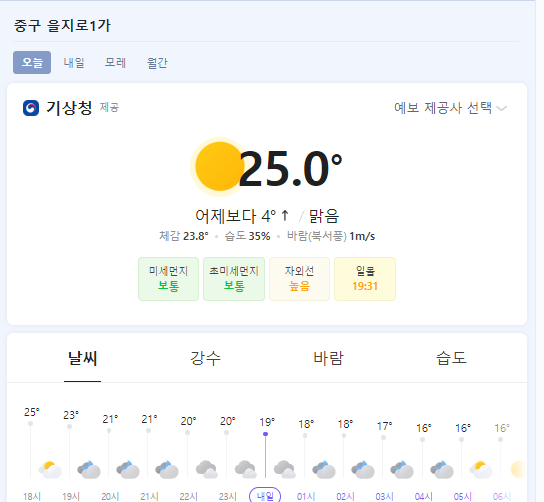

In [11]:
import pyautogui
import time
import pyperclip

pyautogui.moveTo(1436,241,0.2)
pyautogui.click()
time.sleep(0.5)

pyperclip.copy("서울 날씨") 
pyautogui.hotkey("ctrl", "v")
time.sleep(0.5)

pyautogui.write(["enter"]) 
time.sleep(1)

start_x = 987
start_y = 225
end_x = 1531
end_y = 727

pyautogui.screenshot('files\서울날씨.png', region=(start_x, start_y, end_x-start_x, end_y-start_y))


In [ ]:
import pyautogui
import time
import pyperclip

날씨 = ["서울 날씨","시흥 날씨","청주 날씨","부산 날씨","강원도 날씨"]

addr_x = 1436
addr_y = 241
start_x = 987
start_y = 225
end_x = 1531
end_y = 727

for 지역날씨 in 날씨:
    pyautogui.moveTo(addr_x,addr_y,1)
    time.sleep(0.2)
    pyautogui.click()
    time.sleep(0.2)
    pyautogui.write("www.naver.com",interval=0.1)
    pyautogui.write(["enter"])
    time.sleep(1)

    pyperclip.copy(지역날씨) 
    pyautogui.hotkey("ctrl", "v")
    time.sleep(0.5)
    pyautogui.write(["enter"])
    time.sleep(1)
    저장경로 = 'files/' + 지역날씨 + '.png'
    pyautogui.screenshot(저장경로, region=(start_x, start_y, end_x-start_x, end_y-start_y))


## 12. 엑셀의 정보를 불러와 수료증 자동 생성

In [ ]:
pip install openpyxl python-docx docx2pdf
conda install -n forty -c conda-forge pandas

In [12]:
import pandas as pd

df = pd.DataFrame([["홍길동", "1990.01.02", "2021-0001"],
                    ["김민준", "1990.05.06", "2021-0002"],
                    ["김철수", "2000.08.08", "2021-0003"],
                    ["김영희", "2000.09.09", "2021-0004"],
                    ["이서준", "2010.10.10", "2021-0005"],
                    ["장다인", "2017.12.12", "2021-0006"]])

print(df)
df.to_excel('files/수료증명단.xlsx', index=False, header=False)

     0           1          2
0  홍길동  1990.01.02  2021-0001
1  김민준  1990.05.06  2021-0002
2  김철수  2000.08.08  2021-0003
3  김영희  2000.09.09  2021-0004
4  이서준  2010.10.10  2021-0005
5  장다인  2017.12.12  2021-0006


In [13]:
from openpyxl import load_workbook

load_wb = load_workbook('files/수료증명단.xlsx')
load_ws =load_wb.active

name_list = []
birthday_list = []
ho_list = []
for i in range(1,load_ws.max_row + 1):
    name_list.append(load_ws.cell(i, 1).value)
    birthday_list.append(load_ws.cell(i, 2).value)
    ho_list.append(load_ws.cell(i, 3).value)
    
print(name_list)
print(birthday_list)
print(ho_list)

['홍길동', '김민준', '김철수', '김영희', '이서준', '장다인']
['1990.01.02', '1990.05.06', '2000.08.08', '2000.09.09', '2010.10.10', '2017.12.12']
['2021-0001', '2021-0002', '2021-0003', '2021-0004', '2021-0005', '2021-0006']


In [15]:
from docx import Document
from openpyxl import load_workbook
import docx
from docx.oxml.ns import qn
from docx.enum.text import WD_ALIGN_PARAGRAPH
from docx2pdf import convert

load_wb = load_workbook('files/수료증명단.xlsx')
load_ws =load_wb.active

name_list = []
birthday_list = []
ho_list = []
for i in range(1,load_ws.max_row + 1):
    name_list.append(load_ws.cell(i, 1).value)
    birthday_list.append(load_ws.cell(i, 2).value)
    ho_list.append(load_ws.cell(i, 3).value)
    
print(name_list)
print(birthday_list)
print(ho_list)

for i in range(len(name_list)):
    doc = docx.Document('files/수료증양식.docx')
    style = doc.styles['Normal']
    style.font.name = '나눔고딕'
    style._element.rPr.rFonts.set(qn('w:eastAsia'), '나눔고딕')
    style.font.size = docx.shared.Pt(12)
    
    para = doc.add_paragraph()
    run = para.add_run('\n\n') 
    run = para.add_run('              제 '+ ho_list[i] +' 호\n')
    run.font.name = '나눔고딕'
    run._element.rPr.rFonts.set(qn('w:eastAsia'), '나눔고딕')
    run.font.size = docx.shared.Pt(20)

    para = doc.add_paragraph()
    run = para.add_run('\n\n')
    run = para.add_run('수  료  증') 
    run.font.name = '나눔고딕'
    run.bold = True
    run._element.rPr.rFonts.set(qn('w:eastAsia'), '나눔고딕')
    run.font.size = docx.shared.Pt(40)
    para.alignment = WD_ALIGN_PARAGRAPH.CENTER

    para = doc.add_paragraph()
    run = para.add_run('\n\n')
    run = para.add_run('        성       명: ' + name_list[i] +'\n') 
    run.font.name = '나눔고딕'
    run._element.rPr.rFonts.set(qn('w:eastAsia'), '나눔고딕')
    run.font.size = docx.shared.Pt(20)
    run = para.add_run('        생 년 월 일: ' + birthday_list[i] +'\n') 
    run.font.name = '나눔고딕'
    run._element.rPr.rFonts.set(qn('w:eastAsia'), '나눔고딕')
    run.font.size = docx.shared.Pt(20)
    run = para.add_run('        교 육 과 정: 파이썬과 40개의 작품들\n')
    run.font.name = '나눔고딕'
    run._element.rPr.rFonts.set(qn('w:eastAsia'), '나눔고딕')
    run.font.size = docx.shared.Pt(20) 
    run = para.add_run('        교 육 날 짜: 2021.08.05~2021.09.09\n') 
    run.font.name = '나눔고딕'
    run._element.rPr.rFonts.set(qn('w:eastAsia'), '나눔고딕')
    run.font.size = docx.shared.Pt(20)

    para = doc.add_paragraph()
    run = para.add_run('\n\n')
    run = para.add_run('        위 사람은 파이썬과 40개의 작품들 교육과정을\n') 
    run.font.name = '나눔고딕'
    run._element.rPr.rFonts.set(qn('w:eastAsia'), '나눔고딕')
    run.font.size = docx.shared.Pt(20)
    run = para.add_run('        이수하였으므로 이 증서를 수여 합니다.\n') 
    run.font.name = '나눔고딕'
    run._element.rPr.rFonts.set(qn('w:eastAsia'), '나눔고딕')
    run.font.size = docx.shared.Pt(20)

    para = doc.add_paragraph()
    run = para.add_run('\n\n\n')
    run = para.add_run('2021.09.19') 
    run.font.name = '나눔고딕'
    run._element.rPr.rFonts.set(qn('w:eastAsia'), '나눔고딕')
    run.font.size = docx.shared.Pt(20)
    para.alignment = WD_ALIGN_PARAGRAPH.CENTER

    para = doc.add_paragraph()
    run = para.add_run('\n\n\n')
    run = para.add_run('파이썬교육기관장') 
    run.font.name = '나눔고딕'
    run.bold = True
    run._element.rPr.rFonts.set(qn('w:eastAsia'), '나눔고딕')
    run.font.size = docx.shared.Pt(20)
    para.alignment = WD_ALIGN_PARAGRAPH.CENTER

    doc.save('files/'+name_list[i]+'.docx')
    convert('files/'+name_list[i]+'.docx',
            'files/'+name_list[i]+'.pdf')

['홍길동', '김민준', '김철수', '김영희', '이서준', '장다인']
['1990.01.02', '1990.05.06', '2000.08.08', '2000.09.09', '2010.10.10', '2017.12.12']
['2021-0001', '2021-0002', '2021-0003', '2021-0004', '2021-0005', '2021-0006']


100%|██████████| 1/1 [00:02<00:00,  2.30s/it]
